In [ ]:
import os
import pathlib
import time
import datetime
from matplotlib import pyplot as plt
from IPython import display
import tensorflow as tf
tf.__version__

'2.15.0'

In [ ]:
dataset = 'maps'



Other datasets:
* `cityscapes`
* `edges2handbags`
* `edges2shoes`
* `facades`
* `night2day`

(https://github.com/affinelayer/pix2pix-tensorflow#datasets-and-trained-models)

In [ ]:
dataset_file = "{}.tar.gz".format(dataset)
dataset_url = "http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/{}".format(dataset_file)
print(dataset_url)

http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/maps.tar.gz


In [ ]:
download_zip = tf.keras.utils.get_file(fname = dataset_file, origin = dataset_url, extract = True)

250242400/250242400 [==============================] - 115s 0us/step


In [ ]:
download_zip = pathlib.Path(download_zip)
path = download_zip.parent/dataset

In [ ]:
path

PosixPath('/root/.keras/datasets/maps')

In [ ]:
list(path.parent.iterdir())

[PosixPath('/root/.keras/datasets/maps.tar.gz'),
 PosixPath('/root/.keras/datasets/maps')]

In [ ]:
sample = tf.io.read_file(str(path / 'train/13.jpg'))
sample = tf.io.decode_jpeg(sample)

(600, 1200, 3)


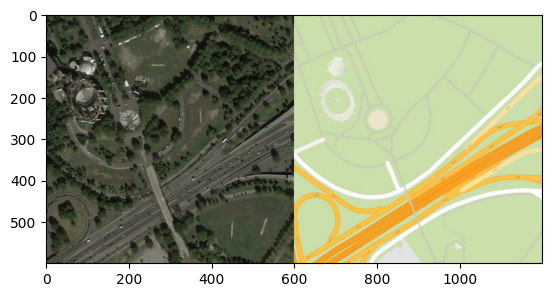

In [ ]:
print(sample.shape)
plt.figure()
plt.imshow(sample);

### Preprocessing

In [ ]:
def load_img(img_path):
  img = tf.io.read_file(img_path)
  img = tf.io.decode_jpeg(img)
  img = tf.image.resize(img, [256, 512])
  print(img.shape)

  width = len(img[1])
  width = width // 2
  print(width)
  original_img = img[:, :width, :] # get original image part from all image
  transformed_img = img[:, width:, :] # get ground truth part from all image


  original_img = tf.cast(original_img, tf.float32)
  transformed_img = tf.cast(transformed_img, tf.float32)

  return original_img, transformed_img

(256, 512, 3)
256


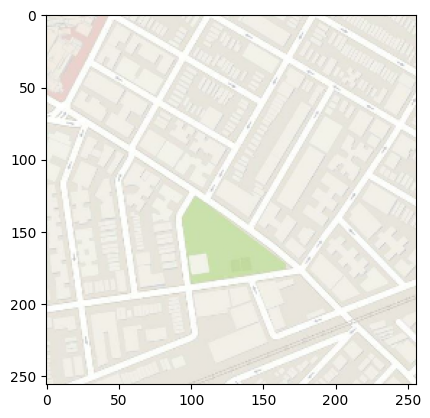

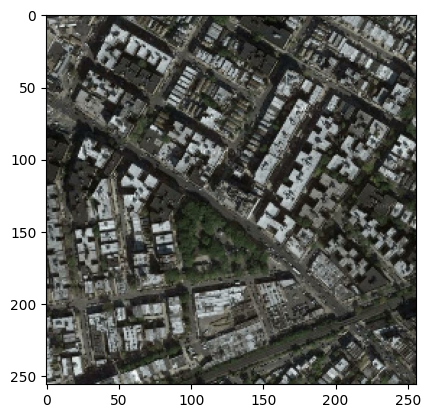

In [ ]:
original_img, transformed_img = load_img(str(path / 'train/5.jpg'))
plt.figure()
plt.imshow(original_img / 255.0)
plt.figure()
plt.imshow(transformed_img / 255.0)

In [ ]:
quantity_training = tf.data.Dataset.list_files(str(path / 'train/*.jpg'))
quantity_training

<_ShuffleDataset element_spec=TensorSpec(shape=(), dtype=tf.string, name=None)>

In [ ]:
quantity_training = len(list(quantity_training))
quantity_training

1096

In [ ]:
BUFFER_SIZE = quantity_training
BATCH_SIZE = 1
IMG_WIDTH = 256
IMG_HEIGHT = 256

In [ ]:
def resize(original_img, transformed_img, width, height):
  original_img = tf.image.resize(original_img, [width,height], method = tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  transformed_img = tf.image.resize(transformed_img, [width,height], method = tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  return original_img, transformed_img

In [ ]:
def normalize(original_img, transformed_img):
  original_img = (original_img/127.5) - 1
  transformed_img = (transformed_img/127.5) - 1
  return original_img, transformed_img

In [ ]:
def random_crop(original_img, transformed_img):
  stacked_img = tf.stack([original_img, transformed_img], axis = 0)
  crop_img = tf.image.random_crop(stacked_img, size= [2, IMG_WIDTH, IMG_HEIGHT, 3]) # it generates 2 image
  return crop_img[0], crop_img[1]

In [ ]:
tf.random.uniform(())

<tf.Tensor: shape=(), dtype=float32, numpy=0.44524574>

In [ ]:
@tf.function()
def random_jitter(original_img, transformed_img):
  original_img, transformed_img = resize(original_img, transformed_img, 286 , 286)
  original_img, transformed_img = random_crop(original_img, transformed_img)
  if tf.random.uniform(()) > 0.5:
    original_img = tf.image.flip_left_right(original_img)
    transformed_img = tf.image.flip_left_right(transformed_img)

  return original_img , transformed_img

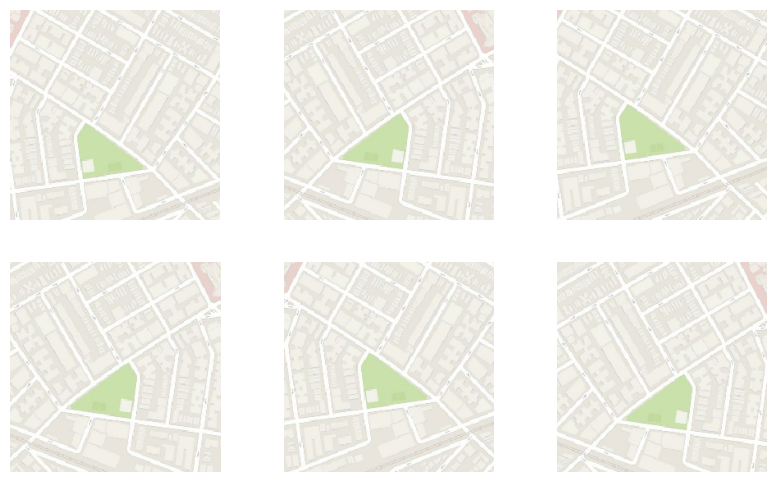

In [ ]:
plt.figure(figsize=(10,6))
for i in range(6):
  j_original, j_transformed =  random_jitter(original_img, transformed_img)
  plt.subplot(2,3, i+1)
  plt.imshow(j_original / 255.0)
  #plt.imshow(j_transformed / 255.0)
  plt.axis('off')
plt.show()

## Loading Dataset

In [ ]:
def loading_training_dataset(img_path):
  original_img, transformed_img = load_img(img_path)
  original_img, transformed_img = random_jitter(original_img, transformed_img)
  original_img, transformed_img = normalize(original_img, transformed_img)
  return original_img, transformed_img

In [ ]:
def loading_test_dataset(img_path):
  original_img, transformed_img = load_img(img_path)
  original_img, transformed_img = resize(original_img, transformed_img, IMG_WIDTH, IMG_HEIGHT)
  original_img, transformed_img = normalize(original_img, transformed_img)
  return original_img, transformed_img

In [ ]:
training_dataset = tf.data.Dataset.list_files(str(path / 'train/*.jpg'))
training_dataset = training_dataset.map(loading_training_dataset, num_parallel_calls = tf.data.AUTOTUNE).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

(256, 512, None)
256


In [ ]:
training_dataset

<_BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None))>

In [ ]:
try:
  test_dataset = tf.data.Dataset.list_files(str(path / 'test/*.jpg'))
except tf.errors.InvalidArgumentError:
  test_dataset = tf.data.Dataset.list_files(str(path / 'val/*.jpg'))

test_dataset = test_dataset.map(loading_test_dataset).batch(BATCH_SIZE)

(256, 512, None)
256


## GENERATOR

UNET Encoding/DownSampling

In [ ]:
def encode(filters, size, apply_batchnorm = True):
  initializer = tf.random_normal_initializer(0, 0.02)
  result = tf.keras.Sequential()
  result.add(tf.keras.layers.Conv2D(filters, size, strides = 2 , padding='same', kernel_initializer= initializer, use_bias =False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())
  result.add(tf.keras.layers.LeakyReLU())
  return result

In [ ]:
original_img.shape

TensorShape([256, 256, 3])

In [ ]:
down_model = encode(3,4)
down_result = down_model(tf.expand_dims(original_img,0))
print(down_result.shape)

(1, 128, 128, 3)


UNET Decoding/UpSampling

In [ ]:
def decode(filters, size, apply_dropout = False):
  initializer = tf.random_normal_initializer(0, 0.02)
  result = tf.keras.Sequential()
  result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides = 2 , padding='same', kernel_initializer= initializer, use_bias =False))
  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
    result.add(tf.keras.layers.Dropout(0.5))
  result.add(tf.keras.layers.LeakyReLU())
  return result

In [ ]:
up_model = decode(3,4)
up_result = up_model(down_result)
#up_result = up_model(tf.expand_dims(original_img,0))
print(up_result.shape)

(1, 256, 256, 3)


In [ ]:
def Generator():
  inputs = tf.keras.layers.Input(shape = [256, 256, 3])

  downsampling = [
      encode(64, 4, apply_batchnorm = False), # (batch_size, 128, 128, 64)
      encode(128, 4), # (batch_size, 64, 64, 128)
      encode(256, 4), # (batch_size, 32, 32, 256)
      encode(512, 4), # (batch_size, 16, 16, 512)
      encode(512, 4), # (batch_size, 8, 8, 512)
      encode(512, 4), # (batch_size, 4, 4, 512)
      encode(512, 4), # (batch_size, 2, 2, 512)
      encode(512, 4), # (batch_size, 1, 1, 512)
  ]

  upsampling = [
      decode(512, 4, apply_dropout=True), # (batch_size, 2, 2, 512)
      decode(512, 4, apply_dropout=True), # (batch_size, 4, 4, 512)
      decode(512, 4, apply_dropout=True), # (batch_size, 8, 8, 512)
      decode(512, 4), # (batch_size, 16, 16, 512)
      decode(256, 4), # (batch_size, 32, 32, 256)
      decode(128, 4), # (batch_size, 64, 64, 128)
      decode(64, 4), # (batch_size, 128, 128, 64)
  ]


  output_channels = 3
  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(output_channels, 4, strides=2, padding='same',
                                         kernel_initializer=initializer, activation='tanh') # (batch_size, 256, 256, 3)

  x = inputs
  skips = []
  for down in downsampling:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  for up, skip in zip(upsampling, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])

  x = last(x)

  return tf.keras.Model(inputs = inputs, outputs = x)


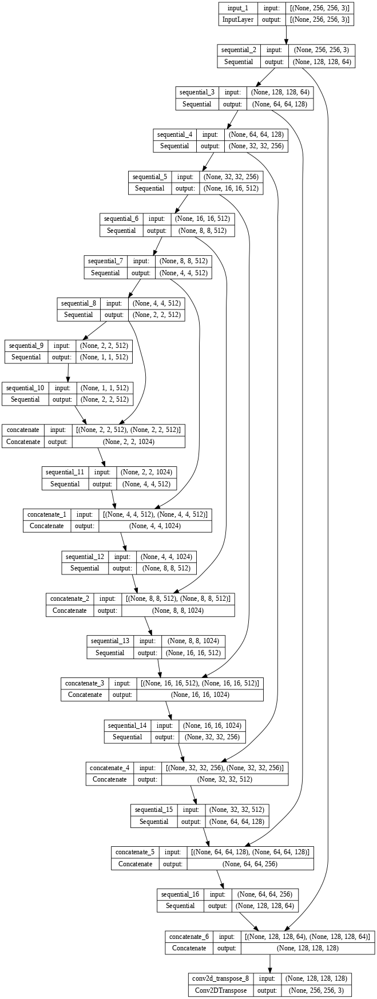

In [ ]:
generator = Generator()
tf.keras.utils.plot_model(generator, show_shapes = True, dpi = 64)

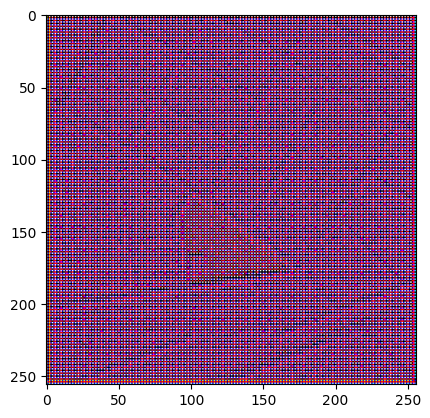

In [ ]:
g_output = generator(original_img[tf.newaxis, ...], training=False)
plt.imshow(g_output[0, ...])

### GENERATOR LOSS

> **Hyperparameters**

Default values suggested in the paper

* Learning rate: 0.0002
* Momentum: [β1, β2] = [0.5, 0.999]
* Lambda (λ_L1) = 100

* The generator loss is a cross-entropy sigmoid of the generated images and an array of 1's
* The pix2pix paper also mentions L1 loss, which is a MAE (Mean Absolute Error) between the generated image and the expected (real) one. This ensures that the generated image becomes structurally similar to the real image.
* The equation for calculating the total loss is gan_loss + LAMBDA * l1_loss where LAMBDA = 100 - this value is also described by the authors of the paper.

In [ ]:
LR = 0.0002
BETA1, BETA2 = 0.5, 0.999
LAMBDA = 100

In [ ]:
loss = tf.keras.losses.BinaryCrossentropy(from_logits = True)

In [ ]:
def generator_loss(d_generated_output, g_output, target):
  gan_loss = loss(tf.ones_like(d_generated_output), d_generated_output)
  l1_loss = tf.reduce_mean(tf.abs(target - g_output)) # MAE
  g_loss_total = gan_loss + (LAMBDA * l1_loss)
  return g_loss_total, gan_loss, l1_loss

### DISCRIMINATOR


The discriminator is a [PatchGAN](https://paperswithcode.com/method/patchgan). The goal is to classify if each patch (piece) of the image is real or fake.

* Blocks of the discriminator: Convolution -> Batch normalization -> Leaky ReLU.

* The output shape is `(batch_size, 30, 30, 1)`

In [ ]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  original = tf.keras.layers.Input(shape = [256,256,3], name='original_img')
  transformed = tf.keras.layers.Input(shape=[256,256,3], name='transformed_img')
  x = tf.keras.layers.concatenate([original, transformed]) # (batch_size, 256, 256, channels * 2)

  down1 = encode(64, 4, False)(x) # (batch_size, 128, 128, 64)
  down2 = encode(128, 4)(down1) # (batch_size, 64, 64, 128)
  down3 = encode(256, 4)(down2) # (batch_size, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3) # (batch_size, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides = 1, kernel_initializer=initializer, use_bias=False)(zero_pad1) # (batch_size, 31, 31, 512)
  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)
  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)
  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (batch_size, 33, 33, 512)
  last = tf.keras.layers.Conv2D(1, 4, strides = 1, kernel_initializer=initializer)(zero_pad2) # (batch_size, 30, 30, 1)

  return tf.keras.Model(inputs = [original, transformed], outputs = last)

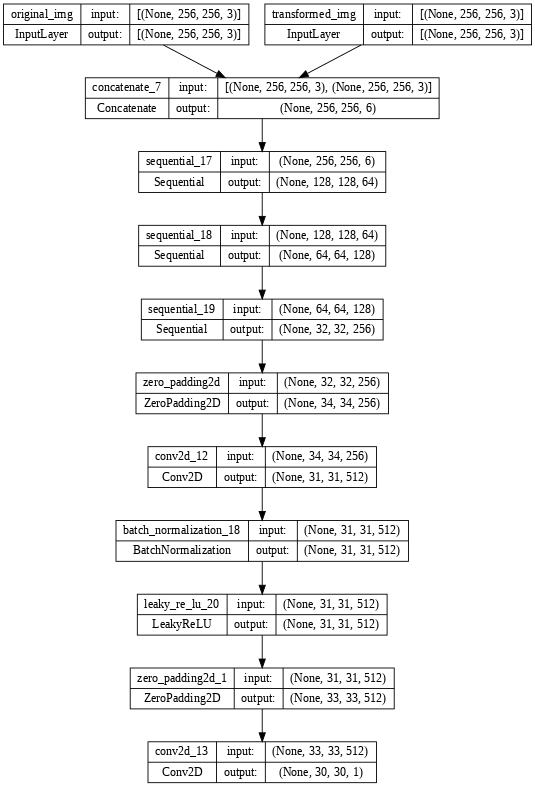

In [ ]:
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes = True, dpi = 64)

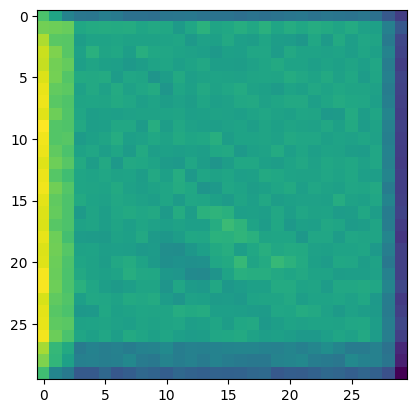

In [ ]:
d_output = discriminator([original_img[tf.newaxis, ...], g_output], training=False)
plt.imshow(d_output[0, ..., -1])

### DISCRIMINATOR LOSS


It receives two inputs: real images and generated (fake) images
* `real_loss` - sigmoid cross-entropy loss comparing the **real** image and one array of 1's
* `generated_loss (fake)` - sigmoid cross-entropy loss comparing the **generated** image and one array of 0's

The total loss is a sum of both losses

In [ ]:
def discriminator_loss(d_real_output, d_generated_output):
  real_loss = loss(tf.ones_like(d_real_output), d_real_output)
  generated_loss = loss(tf.zeros_like(d_generated_output), d_generated_output)
  d_total_loss = real_loss + generated_loss
  return d_total_loss

### OPTIMIZERS

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(LR, beta_1 = BETA1, beta_2 = BETA2)
discriminator_optimizer = tf.keras.optimizers.Adam(LR, beta_1 = BETA1, beta_2 = BETA2)

### MODEL CHECKPOINT

In [ ]:
checkpoint_dir = '/content/training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer = generator_optimizer,
                                 discriminator_optimizer = discriminator_optimizer,
                                 generator = generator,
                                 discriminator = discriminator)

### GENERATING IMAGES

In [ ]:
def generate_images(model, test_input, real, step = None):
  generated_img = model(test_input, training=True)
  plt.figure(figsize=(12,8))

  img_list = [test_input[0], real[0], generated_img[0]]
  title = ['Input image', 'Real (ground truth)', 'Generated image (fake)']

  for i in range(3):
    plt.subplot(1, 3, i + 1)
    plt.title(title[i])
    plt.imshow(img_list[i] * 0.5 + 0.5)
    plt.axis('off')

  if step is not None:
    plt.savefig('result_pix2pix_step_{}.png'.format(step), bbox_inches='tight')

  plt.show()

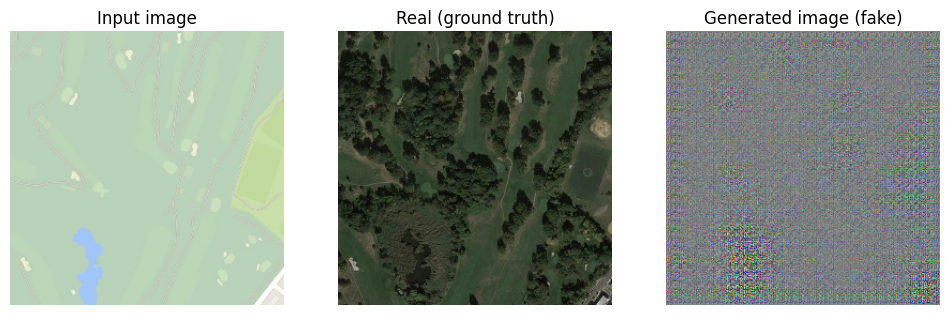

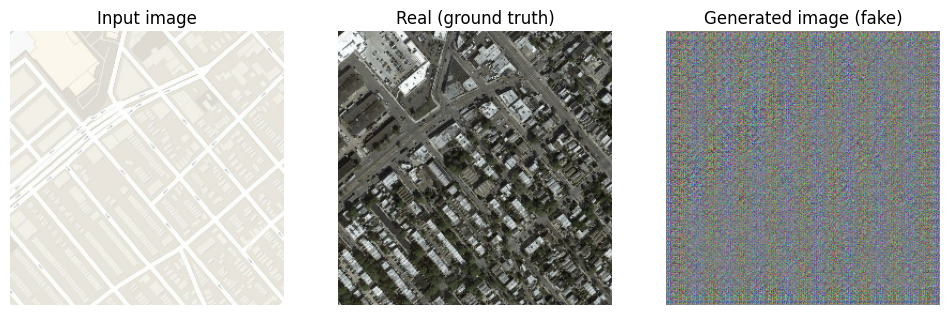

In [ ]:
for input_example, real_example in test_dataset.take(2):
  generate_images(generator, input_example, real_example)

### TRAINING

* For each input, an output is generated.
* The discriminator receives input_img and the generated images as the first input. The second input is img_entry and the "real" (expected)
* Then, the loss of the generator and discriminator is calculated
* Then we calculate the loss gradients with respect to the generator and discriminator variables (inputs) and apply these to the optimizer.

In [ ]:
path_log = 'logs/'
metrics = tf.summary.create_file_writer(path_log + 'fit/' + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [ ]:
@tf.function
def training_step(input_img, real, step):
  with tf.GradientTape() as g_tape, tf.GradientTape() as d_tape:
    g_output = generator(input_img, training = True)

    d_output_real = discriminator([input_img, real], training = True)
    d_output_generated = discriminator([input_img, g_output], training = True)

    g_total_loss, g_loss_gan, g_loss_l1 = generator_loss(d_output_generated, g_output, real)
    d_loss = discriminator_loss(d_output_real, d_output_generated)

  generator_gradients = g_tape.gradient(g_total_loss, generator.trainable_variables)
  discriminator_gradients = d_tape.gradient(d_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients, discriminator.trainable_variables))

  with metrics.as_default():
    tf.summary.scalar('g_total_loss', g_total_loss, step=step//1000)
    tf.summary.scalar('g_loss_gan', g_loss_gan, step=step//1000)
    tf.summary.scalar('g_loss_l1', g_loss_l1, step=step//1000)
    tf.summary.scalar('d_loss', d_loss, step=step//1000)

In [ ]:
def train(training_dataset, testing_dataset, steps, saved_model_name):
  test_input, real_input = next(iter(testing_dataset.take(1)))
  start = time.time()

  for step, (input_img, real_img) in training_dataset.repeat().take(steps).enumerate():
    if step % 1000 == 0:
      display.clear_output(wait = True)
      if step != 0:
        print(f'Time taken to run 1000 steps: {time.time() - start:.2f} seconds\n')
      start = time.time()
      generate_images(generator, test_input, real_input, step)
      print(f'Step: {step//1000}K')
    training_step(input_img, real_img, step)
    if (step + 1) % 10 == 0:
      print('.', end = '', flush = True)
    if (step + 1) % 5000 == 0:
      checkpoint.save(file_prefix=checkpoint_prefix)
      generator.save_weights('{}.h5'.format(saved_model_name))

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir {path_log}

Reusing TensorBoard on port 6006 (pid 3426), started 0:50:06 ago. (Use '!kill 3426' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
#!kill 3426

Time taken to run 1000 steps: 103.01 seconds



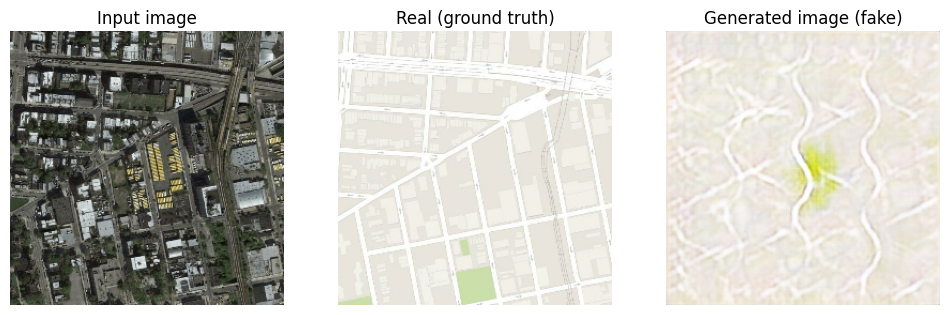

Step: 1K
....................................................................................................

In [ ]:
train(training_dataset, test_dataset, steps = 2000, saved_model_name = 'model_satellite2map') # 40000

### Comments about training

* Note that neither the generator nor the discriminator "win" over each other. If either the `g_loss_gan` or the `d_loss` are too low, it is an indicator that one is dominating the other, which means that it is not training the two together as it should.
* The value `log(2) = 0.69` is a good reference point for these losses, as it indicates that the discriminator is generally uncertain about its evaluation (true or false)
* Considering `d_loss`, a value below 0.69 means that the discriminator is doing better than a random classification on the combined set of real and generated images.
* Considering `g_loss_gan`, a value below 0.69 means that the trained generator is fooling the discriminator better than if it were just random generation
* During training, `g_loss_l1` should decrease.

### CHECKPOINTS

In [ ]:
tf.train.latest_checkpoint(checkpoint_dir)

'/content/training_checkpoints/ckpt-2'

In [ ]:
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

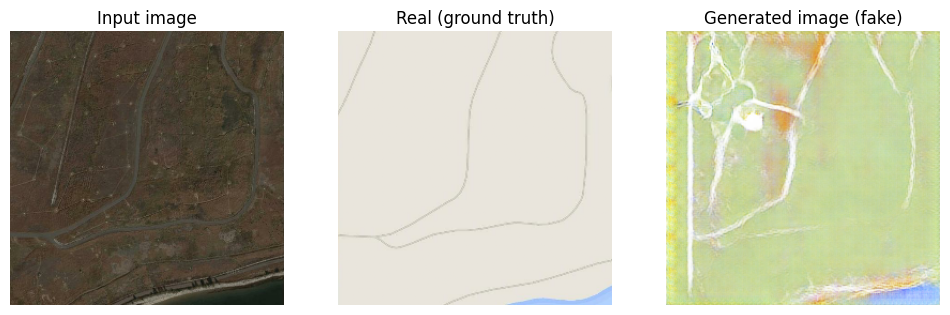

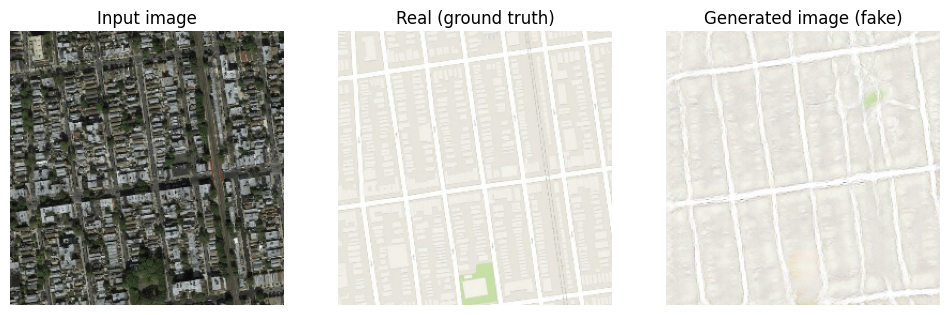

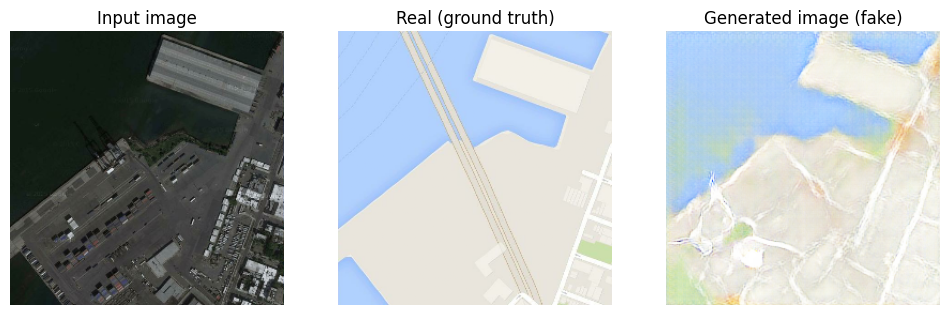

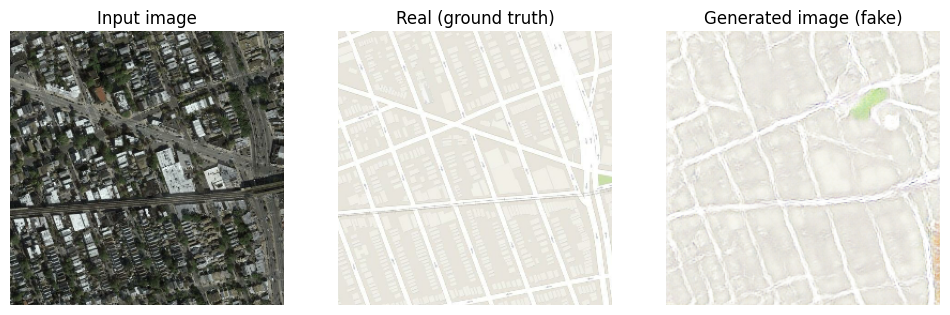

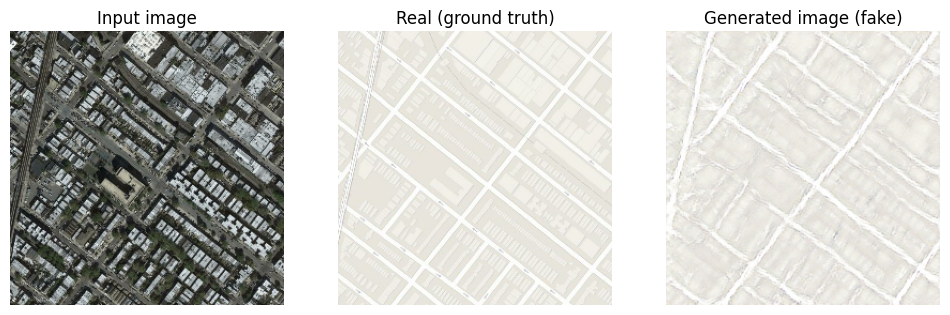

In [ ]:
for satellite, map in test_dataset.take(5):
  generate_images(generator, satellite, map)

Continue to train model from checkpoint

Time taken to run 1000 steps: 106.80 seconds



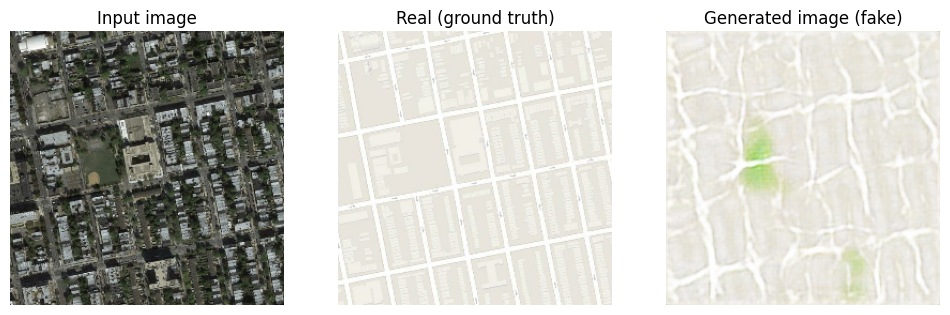

Step: 1K
....................................................................................................

In [ ]:
train(training_dataset, test_dataset, steps = 2000, saved_model_name = "part2_satellite2map")

### Use for prediction

In [ ]:
model2 = Generator()
model2.load_weights('/content/model_pix2pix.h5')

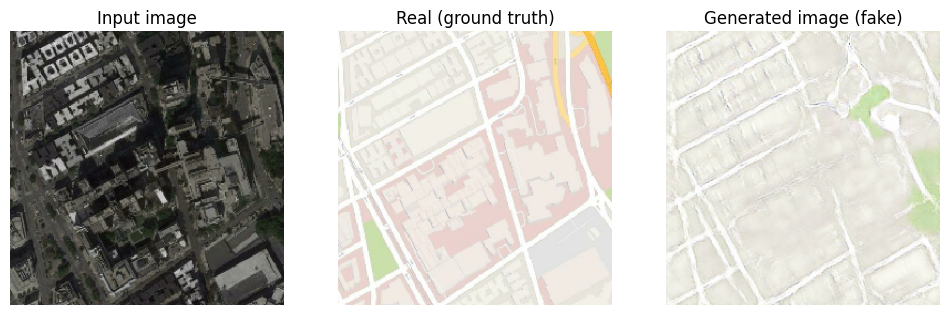

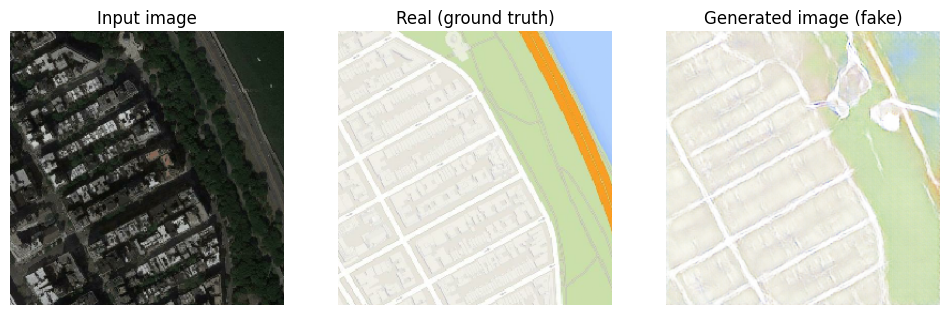

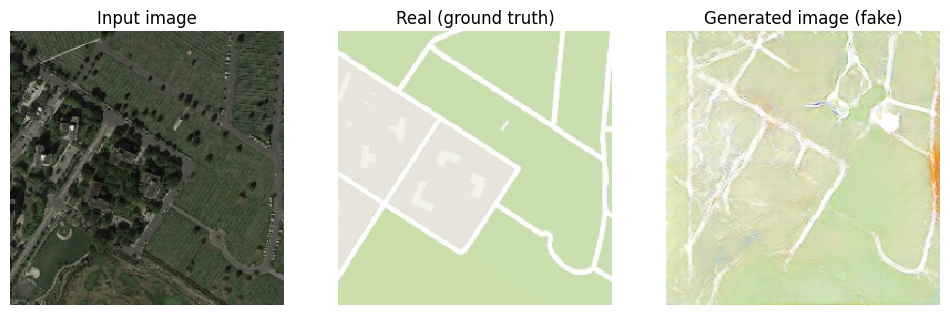

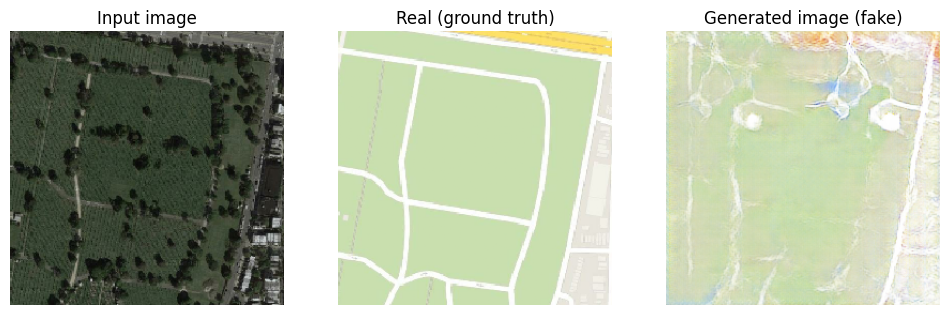

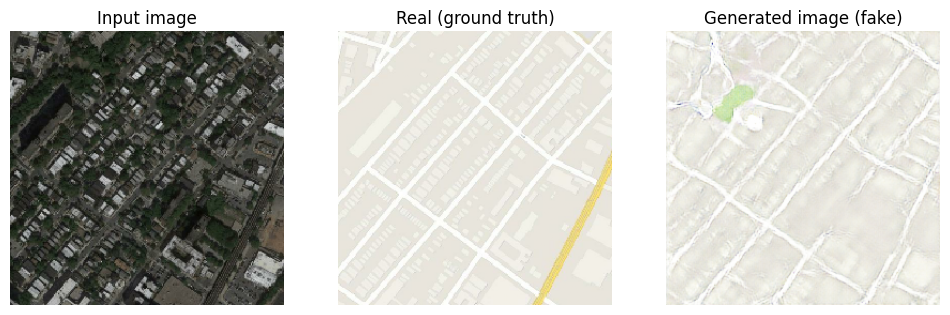

In [ ]:
for s, m in training_dataset.take(5):
  generate_images(model2, s, m)

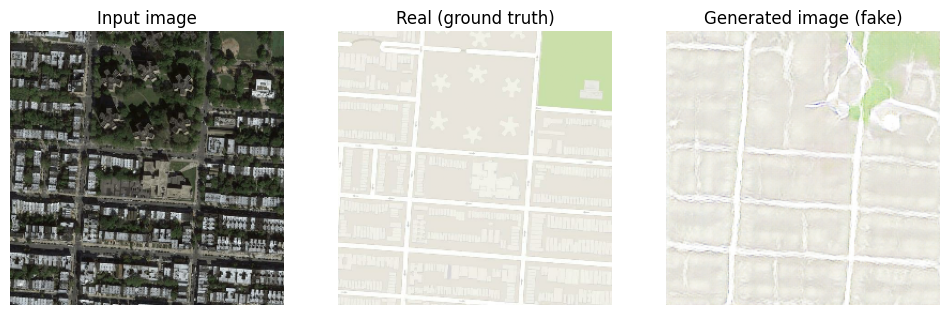

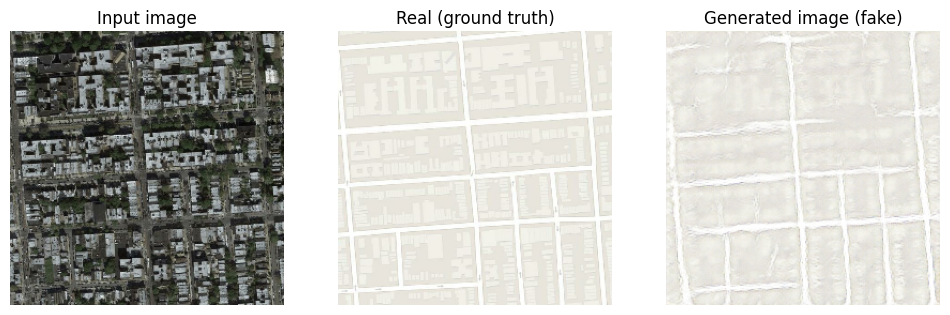

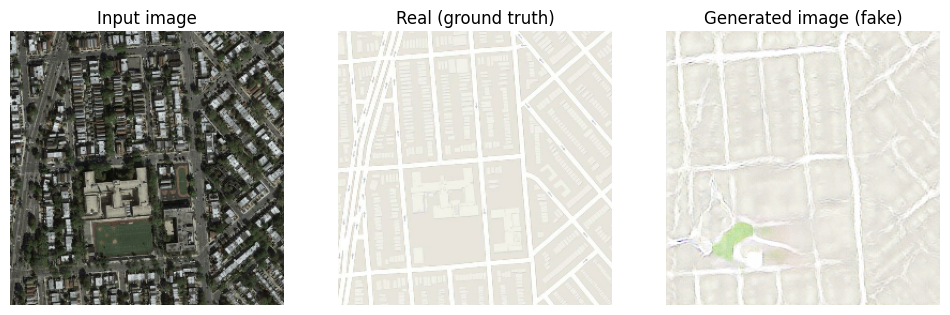

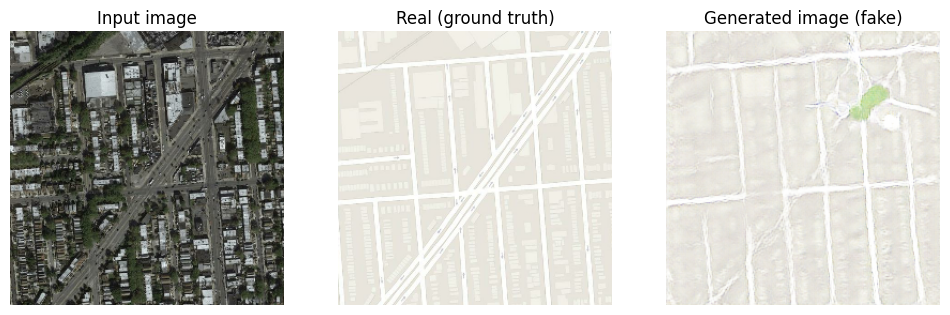

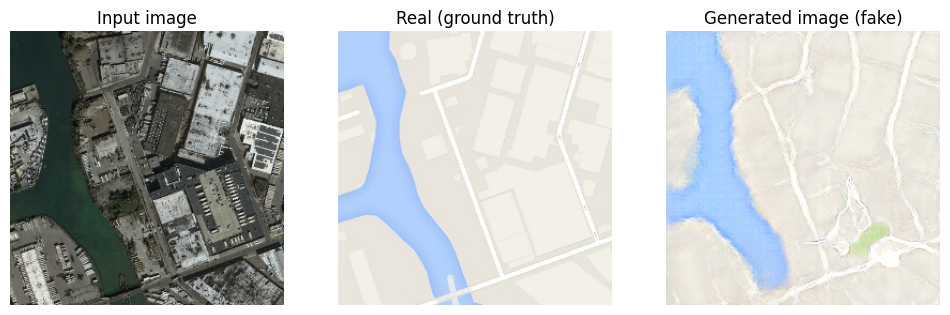

In [ ]:
for satellite, map in test_dataset.take(5):
  generate_images(model2, satellite, map)

# Reverse Version -> Map to Satallite Image

In [ ]:
# CHANGE THIS PART ON THE ABOVE PART
def load_img(img_path):
  img = tf.io.read_file(img_path)
  img = tf.io.decode_jpeg(img)
  img = tf.image.resize(img, [256, 512])
  print(img.shape)

  width = len(img[1])
  width = width // 2
  print(width)
  original_img = img[:, width:, :] # get original image part from all image
  transformed_img = img[:, :width, :] # get ground truth part from all image


  original_img = tf.cast(original_img, tf.float32)
  transformed_img = tf.cast(transformed_img, tf.float32)

  return original_img, transformed_img

In [ ]:
checkpoint_dir = '/content/training_checkpoints_map2satellite' # CHANGE THIS PART ON THE ABOVE PART
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer = generator_optimizer,
                                 discriminator_optimizer = discriminator_optimizer,
                                 generator = generator,
                                 discriminator = discriminator)

In [ ]:
path_log = 'logs_map2satellite/' # CHANGE THIS PART ON THE ABOVE PART
metrics = tf.summary.create_file_writer(path_log + 'fit/' + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

We need to re-define generator object

Time taken to run 1000 steps: 94.91 seconds



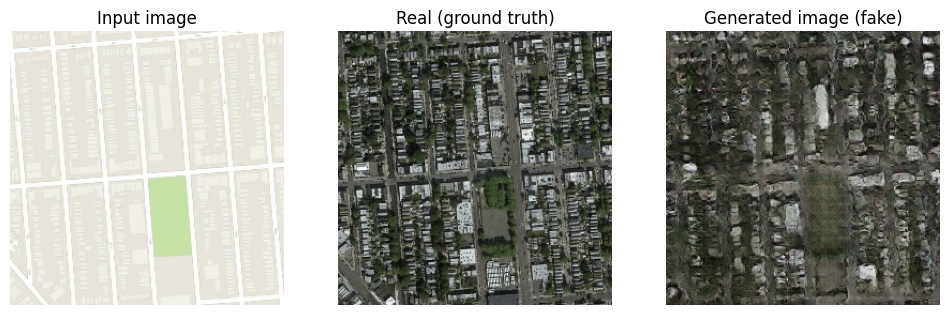

Step: 39K
....................................................................................................

In [ ]:
train(training_dataset, test_dataset, steps = 40000, saved_model_name = 'model_map2satellite') # CHANGE THIS PART ON THE ABOVE PART

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir {path_log}